In [1]:
import lws
from librosa.display import specshow
import librosa
import random
import numpy as np
import math
import IPython.display as ipd
import matplotlib.pyplot as plt
from matplotlib import cm
%matplotlib inline

In [2]:
# Load audio.
path = './audio_datasets/vocals_trimmed.wav'

# Settings.
fft_size = 2048
hop_length = fft_size // 4
mode = 'music'
perfect_reconstruction = True

lws_processor = lws.lws(fft_size,
                        hop_length,
                        mode=mode,
                        perfectrec=perfect_reconstruction) 

data, sample_rate = librosa.load(path, mono=True)

In [3]:
# Create mags.
stfts = lws_processor.stft(data)
magnitudes = np.abs(stfts)

## Original audio

In [4]:
ipd.Audio(data, rate=sample_rate)

## Original Audio, Estimated Phases

In [5]:
double_mags = magnitudes.astype(np.float64)
predicted_stfts = lws_processor.run_lws(double_mags)
predicted_audio = lws_processor.istft(predicted_stfts)
ipd.Audio(predicted_audio, rate=sample_rate)

/home/eavi/leon/leon/lib/python3.5/site-packages/librosa/display.py:656: FutureWarning: Conversion of the second argument of issubdtype from `complex` to `np.complexfloating` is deprecated. In future, it will be treated as `np.complex128 == np.dtype(complex).type`.
  if np.issubdtype(data.dtype, np.complex):


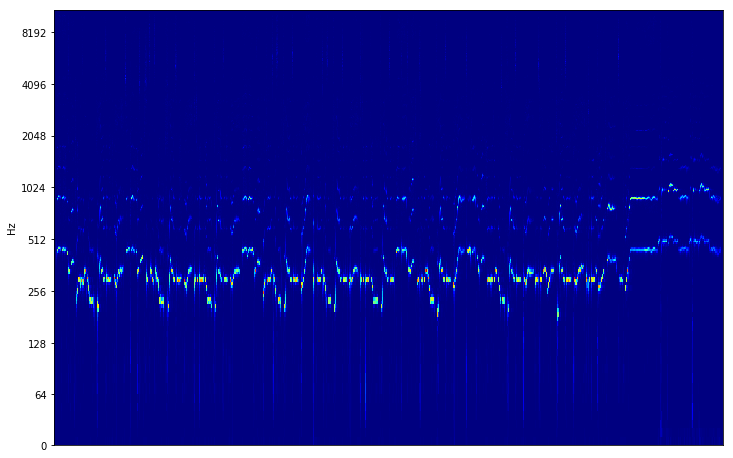

In [6]:
plt.figure(figsize=(12, 8))
specshow(data=double_mags.T, 
         sr=sample_rate, 
         y_axis='log',
         cmap=cm.jet)
plt.show()

## Zero Cancelled Spectral Noise, Estimated Phases

In [7]:
def random_masking(mags, masking_prob):
    mask = np.random.choice([0, 1], size=mags.shape, 
                            p=[masking_prob, 1.0 - masking_prob])
    return mask.astype(mags.dtype) * mags


double_mags = magnitudes.astype(np.float64)
double_mags = random_masking(double_mags, 0.5)
predicted_stfts = lws_processor.run_lws(double_mags)
predicted_audio = lws_processor.istft(predicted_stfts)
ipd.Audio(predicted_audio, rate=sample_rate)

/home/eavi/leon/leon/lib/python3.5/site-packages/librosa/display.py:656: FutureWarning: Conversion of the second argument of issubdtype from `complex` to `np.complexfloating` is deprecated. In future, it will be treated as `np.complex128 == np.dtype(complex).type`.
  if np.issubdtype(data.dtype, np.complex):


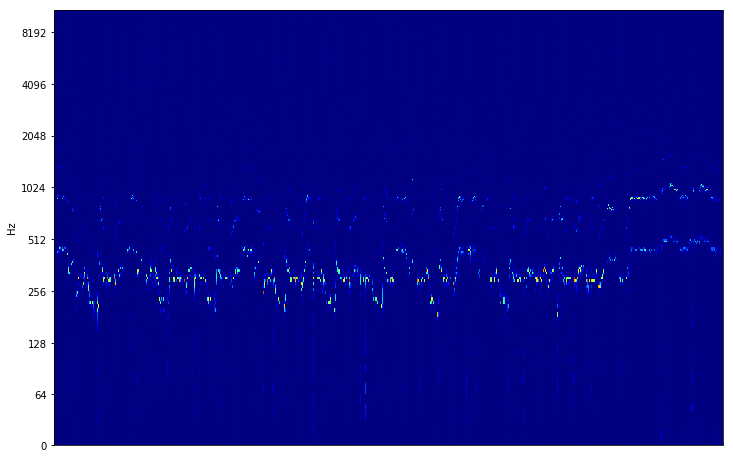

In [8]:
plt.figure(figsize=(12, 8))
specshow(data=double_mags.T, 
         sr=sample_rate, 
         y_axis='log',
         cmap=cm.jet)
plt.show()

## Additive Spectral Noise, Estimated Phases

In [16]:
def additive_noise(mags, high=1.0):
    noise = np.random.uniform(high=high, size=mags.shape)
    return noise.astype(mags.dtype) + mags


double_mags = magnitudes.astype(np.float64)
double_mags = additive_noise(double_mags, 0.1)
predicted_stfts = lws_processor.run_lws(double_mags)
predicted_audio = lws_processor.istft(predicted_stfts)
ipd.Audio(predicted_audio, rate=sample_rate)

/home/eavi/leon/leon/lib/python3.5/site-packages/librosa/display.py:656: FutureWarning: Conversion of the second argument of issubdtype from `complex` to `np.complexfloating` is deprecated. In future, it will be treated as `np.complex128 == np.dtype(complex).type`.
  if np.issubdtype(data.dtype, np.complex):


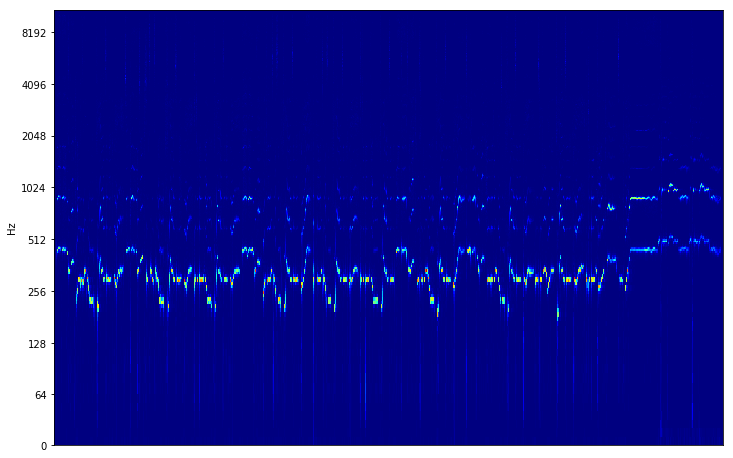

In [17]:
plt.figure(figsize=(12, 8))
specshow(data=double_mags.T, 
         sr=sample_rate, 
         y_axis='log',
         cmap=cm.jet)
plt.show()

## Multiplacative Spectral Noise, Estimated Phases

In [18]:
def multiplacative_noise(mags, high=1.0):
    noise = np.random.uniform(high=high, size=mags.shape)
    return noise.astype(mags.dtype) * mags


double_mags = magnitudes.astype(np.float64)
double_mags = multiplacative_noise(double_mags, 1.0)
predicted_stfts = lws_processor.run_lws(double_mags)
predicted_audio = lws_processor.istft(predicted_stfts)
ipd.Audio(predicted_audio, rate=sample_rate)

/home/eavi/leon/leon/lib/python3.5/site-packages/librosa/display.py:656: FutureWarning: Conversion of the second argument of issubdtype from `complex` to `np.complexfloating` is deprecated. In future, it will be treated as `np.complex128 == np.dtype(complex).type`.
  if np.issubdtype(data.dtype, np.complex):


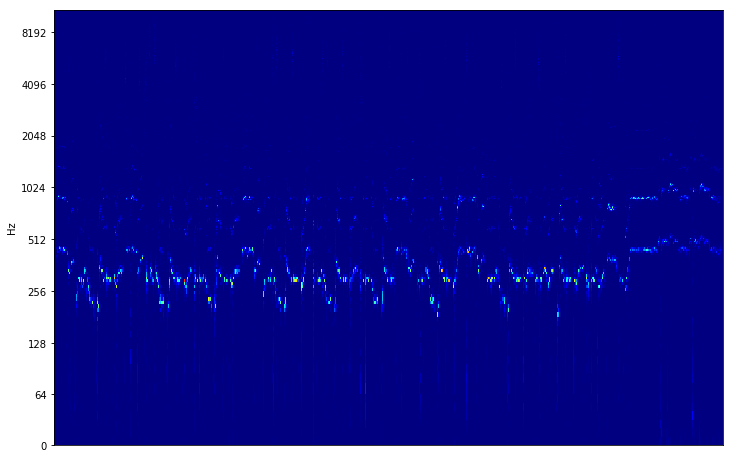

In [19]:
plt.figure(figsize=(12, 8))
specshow(data=double_mags.T, 
         sr=sample_rate, 
         y_axis='log',
         cmap=cm.jet)
plt.show()

In [13]:
def random_occlusion(mags, min_amount, max_amount):
    width, height = mags.shape
    
    def random_from_exp(amount_min, amount_max, exp): 
        return random.uniform(amount_min, math.sqrt(amount_max))**exp
    
    min_width = int(min_amount * width)
    max_width = int(max_amount * width)
    min_height = int(min_amount * height)
    max_height = int(max_amount * height)
    
    noise_width = np.random.randint(min_width, max_width)
    noise_height = np.random.randint(min_height, max_height)
    
    x_start = np.random.randint(width - noise_width)
    y_start = int((random_from_exp(0, 10, 2) / 10) * (height - noise_height))
    
    x_end = x_start + noise_width
    y_end = y_start + noise_height

    shape = mags[x_start:x_end:, y_start:y_end:].shape
    
    noise = np.random.normal(loc=np.mean(mags), 
                             scale=np.std(mags), 
                             size=shape)
    mags[x_start:x_end:, y_start:y_end:] = noise
    return mags


    
double_mags = magnitudes.astype(np.float64)
double_mags = random_occlusion(double_mags, 0.0, 0.2)
predicted_stfts = lws_processor.run_lws(double_mags)
predicted_audio = lws_processor.istft(predicted_stfts)
ipd.Audio(predicted_audio, rate=sample_rate)

/home/eavi/leon/leon/lib/python3.5/site-packages/librosa/display.py:656: FutureWarning: Conversion of the second argument of issubdtype from `complex` to `np.complexfloating` is deprecated. In future, it will be treated as `np.complex128 == np.dtype(complex).type`.
  if np.issubdtype(data.dtype, np.complex):


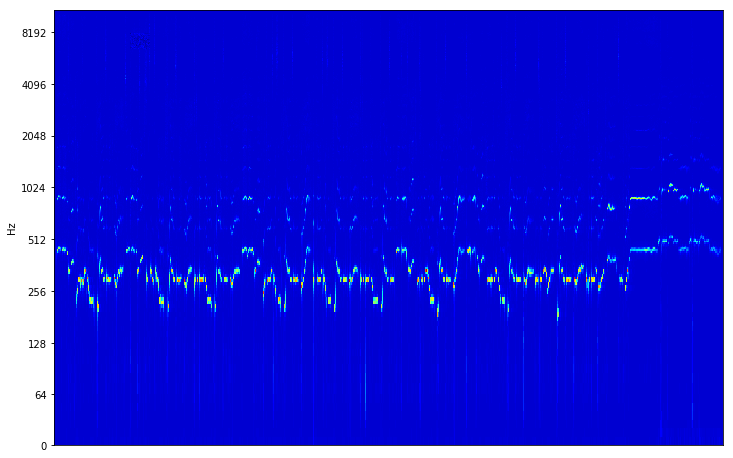

In [14]:
plt.figure(figsize=(12, 8))
specshow(data=double_mags.T, 
         sr=sample_rate, 
         y_axis='log',
         cmap=cm.jet)
plt.show()

/home/eavi/leon/leon/lib/python3.5/site-packages/librosa/display.py:656: FutureWarning: Conversion of the second argument of issubdtype from `complex` to `np.complexfloating` is deprecated. In future, it will be treated as `np.complex128 == np.dtype(complex).type`.
  if np.issubdtype(data.dtype, np.complex):


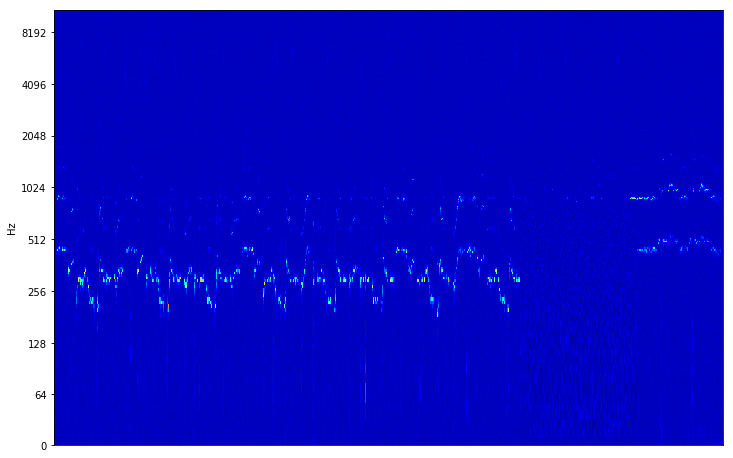

In [40]:
def _random_occlusion(mags, min_amount, max_amount):
    width, height = mags.shape
    
    def random_from_exp(amount_min, amount_max, exp): 
        return random.uniform(amount_min, math.sqrt(amount_max))**exp
    
    min_width = int(min_amount * width)
    max_width = int(max_amount * width)
    min_height = int(min_amount * height)
    max_height = int(max_amount * height)
    
    noise_width = np.random.randint(min_width, max_width)
    noise_height = np.random.randint(min_height, max_height)
    
    x_start = np.random.randint(width - noise_width)
    y_start = int((random_from_exp(0, 10, 2) / 10) * (height - noise_height))
    
    x_end = x_start + noise_width
    y_end = y_start + noise_height

    shape = mags[x_start:x_end:, y_start:y_end:].shape
    
    noise = np.random.normal(loc=np.mean(mags), 
                             scale=np.std(mags), 
                             size=shape)
    mags[x_start:x_end:, y_start:y_end:] = noise
    return mags


def _multiplacative_noise(mags, high=1.0):
    high = np.random.random_sample() * high
    noise = np.random.uniform(high=high, size=mags.shape)
    return noise.astype(mags.dtype) * mags


def _additive_noise(mags, high=1.0):
    high = np.random.random_sample() * high
    noise = np.random.uniform(high=high, size=mags.shape)
    return noise.astype(mags.dtype) + mags


def _random_masking(mags, masking_prob):
    masking_prob = np.random.random_sample() * masking_prob
    mask = np.random.choice([0, 1], size=mags.shape, 
                            p=[masking_prob, 1.0 - masking_prob])
    return mask.astype(mags.dtype) * mags


class OnlineAudioAugmentor():
    
    def __init__(self):
        self.prob_random_occlusion = 0
        self.prob_additive_noise = 0
        self.prob_multiplacative_noise = 0
        self.prob_random_masking = 0
    
    def random_occlusion(self, prob, min_amount, max_amount):
        self.prob_random_occlusion = prob
        self.min_amount_random_occlusion = min_amount
        self.max_amount_random_occlusion = max_amount

    def additive_noise(self, prob, high):
        self.prob_additive_noise = prob
        self.high_additive_noise = high
    
    def multiplacative_noise(self, prob, high):
        self.prob_multiplacative_noise = prob
        self.high_multiplacative_noise = high
    
    def random_masking(self, prob, masking_prob):
        self.prob_random_masking = prob
        self.masking_prob_random_masking = masking_prob
        
    def augment(self, mags):
        
        if np.random.random_sample() < self.prob_multiplacative_noise:
            mags = _multiplacative_noise(mags, self.high_multiplacative_noise)
        
        if np.random.random_sample() < self.prob_random_occlusion:
            mags = _random_occlusion(mags, 
                                      self.min_amount_random_occlusion,
                                      self.max_amount_random_occlusion)

        if np.random.random_sample() < self.prob_additive_noise:
            mags = _additive_noise(mags, self.high_additive_noise)
            
        if np.random.random_sample() < self.prob_random_masking:
            mags = _random_masking(mags, self.masking_prob_random_masking)
            
        return mags
    
    
augmentive_prob = 0.5

augmentor = OnlineAudioAugmentor()

augmentor.additive_noise(augmentive_prob, 0.1)
augmentor.multiplacative_noise(augmentive_prob, 0.1)
augmentor.random_masking(augmentive_prob, 0.5)
augmentor.random_occlusion(augmentive_prob, 0.0, 0.5)

double_mags = magnitudes.astype(np.float64)
double_mags = augmentor.augment(double_mags)

plt.figure(figsize=(12, 8))
specshow(data=double_mags.T, 
         sr=sample_rate, 
         y_axis='log',
         cmap=cm.jet)
plt.show()

In [41]:
predicted_stfts = lws_processor.run_lws(double_mags)
predicted_audio = lws_processor.istft(predicted_stfts)
ipd.Audio(predicted_audio, rate=sample_rate)